# Spatial Weights

Using spatial weights to explore spatial disparities

In [1]:
import geopandas
import libpysal
import numpy
%matplotlib inline

In [2]:
df = geopandas.read_file('data/scag_region.gpkg')
df.fillna(df.mean(), inplace=True)

https://www.azavea.com/blog/2019/05/02/analyzing-life-expectancy-in-python/

In [3]:
wq = libpysal.weights.Queen.from_dataframe(df)

/Users/knaaptime/anaconda3/envs/pysal-workshop/lib/python3.7/site-packages/libpysal/weights/weights.py:167: UserWarning: The weights matrix is not fully connected: 
 There are 3 disconnected components.
 There is 1 island with id: 4285.
  warnings.warn(message)


In [4]:
hv = df['median_home_value'].values

In [5]:
hv

array([647272.65917603, 400842.97752809, 416741.66666667, ...,
       293254.58801498, 255794.66292135, 581717.79026217])

## Find maximum pairwise difference in hv

In [6]:
pw_diff = numpy.abs(hv[:, numpy.newaxis] - hv)


In [7]:
wq.neighbors[0]

[3331, 36, 1285, 3333, 3046, 4485, 1324, 1326, 4151]

In [8]:
W = wq.full()[0]


In [9]:
pw_sdiff = W * pw_diff

In [10]:
pw_sdiff[0, wq.neighbors[0]]

array([149621.91011236,  12958.52059925,  13176.31086142, 105954.96254682,
        32450.74906367, 148532.9588015 , 296412.54681648, 151582.02247191,
        40617.88389513])

In [11]:
pw_sdiff.max()

1005429.8342696631

In [12]:
d_idx = numpy.where(pw_sdiff == pw_sdiff.max())[0]

In [13]:
hv[d_idx]

array([1088952.39981273,   83522.56554307])

In [14]:
d_idx

array([  55, 1518])

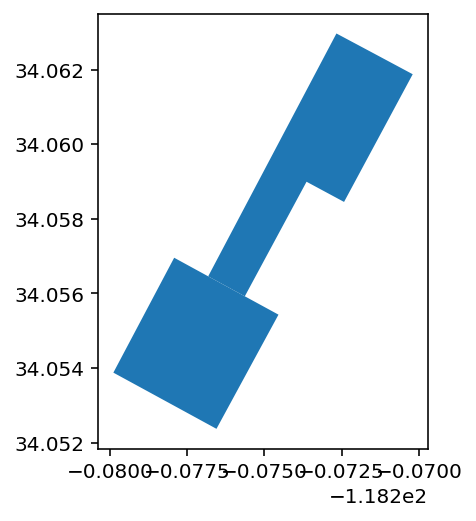

In [15]:
df.iloc[d_idx].plot()

In [16]:
df.iloc[d_idx].head()

,geoid,n_asian_under_15,n_black_under_15,n_hispanic_under_15,n_native_under_15,n_white_under_15,n_persons_under_18,n_asian_over_60,n_black_over_60,n_hispanic_over_60,...,year,n_total_housing_units_sample,p_nonhisp_white_persons,p_white_over_60,p_black_over_60,p_hispanic_over_60,p_native_over_60,p_asian_over_60,p_disabled,geometry
55,06037208903,22.0,0.0,562.0,0.0,0.0,669.0,NaN,NaN,NaN,...,2010,1305.0,6.022099,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.27682 34.05646, -118.27267 34.0..."
1518,06037209402,22.0,15.0,651.0,18.0,0.0,841.0,NaN,NaN,NaN,...,2010,1246.0,3.399123,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.27893 34.05538, -118.27792 34.0..."


In [17]:
df.iloc[d_idx]['median_home_value']

55      1.088952e+06
1518    8.352257e+04
Name: median_home_value, dtype: float64

In [18]:
import numpy as np
def largest_indices(ary, n):
    """Returns the n largest indices from a numpy array."""
    flat = ary.flatten()
    indices = np.argpartition(flat, -n)[-n:]
    indices = indices[np.argsort(-flat[indices])]
    return np.unravel_index(indices, ary.shape)

In [19]:
 xs = np.sin(np.arange(9)).reshape((3, 3))

In [20]:
xs

array([[ 0.        ,  0.84147098,  0.90929743],
       [ 0.14112001, -0.7568025 , -0.95892427],
       [-0.2794155 ,  0.6569866 ,  0.98935825]])

In [21]:
largest_indices(xs, 3)

(array([2, 0, 0]), array([2, 2, 1]))

In [22]:
largest_indices(pw_sdiff, 10)

(array([1518,   55, 2675, 4247, 2330, 2770, 4008, 3219, 1603, 1729]),
 array([  55, 1518, 4247, 2675, 2770, 2330, 3219, 4008, 1729, 1603]))

In [23]:
pw_sdiff[largest_indices(pw_sdiff, 10)]

array([1005429.83426966, 1005429.83426966,  895009.082397  ,
        895009.082397  ,  873666.72565543,  873666.72565543,
        866588.54213483,  866588.54213483,  866479.64700375,
        866479.64700375])

In [24]:
idxs = largest_indices(pw_sdiff, 10)

In [25]:
c_idxs = np.unique(np.concatenate(idxs))

In [26]:
c_idxs

array([  55, 1518, 1603, 1729, 2330, 2675, 2770, 3219, 4008, 4247])

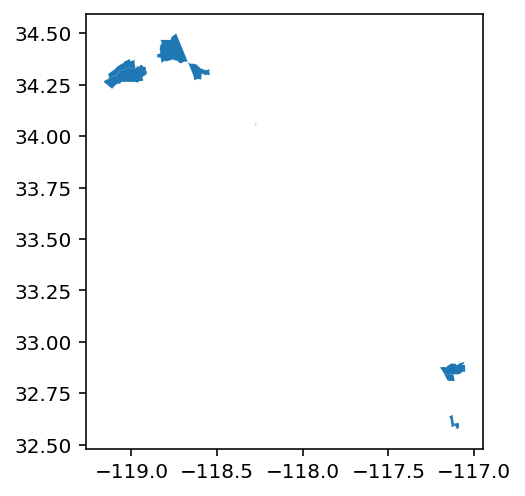

In [27]:
df.iloc[c_idxs].plot()

In [28]:
n,k = df.shape
pair_diff = np.zeros((n,1))
pair_diff[c_idxs] = 1

In [29]:
df['pair_diff'] = pair_diff

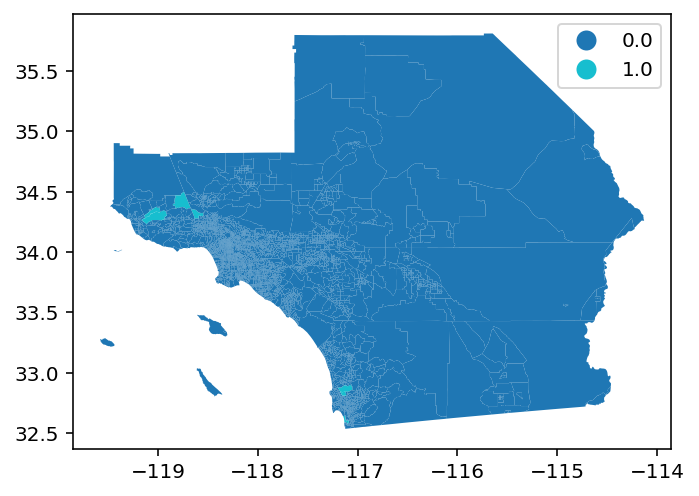

In [30]:
df.plot(column='pair_diff', categorical='True', legend=True)

In [31]:
import folium
from folium.plugins import MarkerCluster

In [32]:
m = folium.Map(tiles='cartodbpositron', min_zoom=4, zoom_start=4.25, 
               max_bounds=True,location=[33.8283459,-98.5794797],
               min_lat=5.499550, min_lon=-160.276413, 
               max_lat=83.162102, max_lon=-52.233040)


In [33]:
df.to_file('data/pairs.geojson',  driver='GeoJSON')

In [34]:
min_lon, min_lat, max_lon, max_lat = df.total_bounds
c_lon = (max_lon + min_lon)/2
c_lat = (max_lat + min_lat)/2

In [35]:
m = folium.Map(tiles='cartodbpositron', min_zoom=4, zoom_start=7, 
               max_bounds=True,location=[c_lon, c_lat],
               min_lat=min_lat, min_lon=min_lon, 
               max_lat=max_lat, max_lon=max_lon)
marker_cluster = MarkerCluster(
    options = {'maxClusterRadius':15, 
               'disableCusteringAtZoom':5, 
               'singleMarkerMode':True}).add_to(m)
folium.Choropleth(
    geo_data = 'data/pairs.geojson',
    data = df,
    columns = ['geoid','median_home_value'],
    fill_color = 'YlGn',
    key_on = 'feature.properties.geoid',
    name = 'geojson',
    legend_name='median_home_value'
).add_to(m)
for i, tract in df.iloc[c_idxs].iterrows():   #top_50_tracts_gdf.iterrows():
    x = tract.geometry.centroid.x
    y = tract.geometry.centroid.y
    l = tract.median_home_value
    folium.CircleMarker([y, x], radius=8, color='black', 
                        fill_color='white', fill_opacity=0.5, 
                        tooltip='Median House Value: {}'.format(str(l))).add_to(marker_cluster)
f = folium.Figure()
title = '<h2>Spatial Housing Markets</h2>'
subtitle = '<h4><i>Census tract neighbors across ' + \
           'Southern California with the widest disparities ' + \
           'in home values<i></h4>'
f.html.add_child(folium.Element(title))
f.html.add_child(folium.Element(subtitle))
f.add_child(m)
f

In [36]:
df.head()

,geoid,n_asian_under_15,n_black_under_15,n_hispanic_under_15,n_native_under_15,n_white_under_15,n_persons_under_18,n_asian_over_60,n_black_over_60,n_hispanic_over_60,...,n_total_housing_units_sample,p_nonhisp_white_persons,p_white_over_60,p_black_over_60,p_hispanic_over_60,p_native_over_60,p_asian_over_60,p_disabled,geometry,pair_diff
0,06037128702,58.0,0.0,223.0,0.0,475.0,986.0,NaN,NaN,NaN,...,2903.0,64.726214,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.44870 34.16485, -118.43997 34.1...",0.0
1,06037131600,83.0,62.0,777.0,0.0,135.0,1355.0,NaN,NaN,NaN,...,1487.0,28.679979,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.56229 34.22033, -118.55792 34.2...",0.0
2,06037134104,287.0,17.0,816.0,0.0,61.0,1323.0,NaN,NaN,NaN,...,1388.0,14.846188,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.57976 34.21558, -118.57539 34.2...",0.0
3,06037134304,90.0,24.0,298.0,0.0,89.0,520.0,NaN,NaN,NaN,...,928.0,33.378933,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.61472 34.21952, -118.61039 34.2...",0.0
4,06037242000,0.0,229.0,681.0,0.0,0.0,1164.0,NaN,NaN,NaN,...,1054.0,0.058565,NaN,NaN,NaN,NaN,NaN,NaN,"POLYGON ((-118.25416 33.93882, -118.25413 33.9...",0.0
